# Assignment 10: Feature Extraction and Image Matching
Tổng quan: Ở bài tập này, chúng ta sẽ thực hành lập trình một số hàm trích xuất đặc trưng ảnh cơ bản, sau đó ứng dụng cho các bài toán tạo ảnh panorama và bài toán đối sánh để tìm kiếm ảnh.

- Histogram of Oriented Gradients (HOG)
- Scale-Invariant Feature Transform (SIFT)
- Speeded-Up Robust Features (SURF)

Yêu cầu thư viện: OpenCV 3.3, matplotlib, skimage 

In [1]:
from IPython.display import Image

from skimage.feature import hog
import skimage

import matplotlib.pyplot as plt
import os
import cv2
import numpy as np

## I. Histogram of Oriented Gradients (HOG)
Histogram of Oriented Gradients (HOG) là bộ mô tả đặc trưng thường được sử dụng trong thị giác máy tính và xử lí ảnh để biểu diễn đối tượng trong ảnh

Thư viện scikit-image (skimage) cung cấp hàm skimage.feature.hog() để trích chọn đặc trưng HOG. Một số tham số quan trọng của hàm như sau:
- orientations: Number of orientation bins.
- pixels_per_cell: Size (in pixels) of a cell.
- cells_per_block: Number of cells in each block.

Xem đầy đủ tại: http://scikit-image.org/docs/dev/api/skimage.feature.html#skimage.feature.hog

Tutorial chi tiết về HOG: https://www.learnopencv.com/histogram-of-oriented-gradients/

/usr/local/lib/python3.5/dist-packages/skimage/feature/_hog.py:150: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15. To supress this message specify explicitly the normalization method.
  skimage_deprecation)


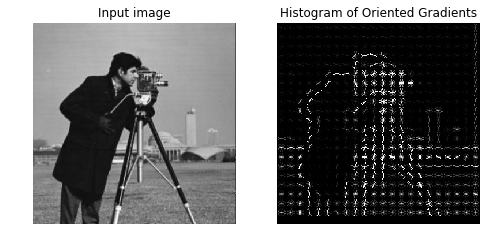

In [2]:
image = cv2.imread('man.png')

fd, hog_image = hog(image, orientations=8, pixels_per_cell=(16, 16),
                    cells_per_block=(1, 1), visualize=True, multichannel=True)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 4), sharex=True, sharey=True)

ax1.axis('off')
ax1.imshow(image, cmap=plt.cm.gray)
ax1.set_title('Input image')

# Rescale histogram for better display
hog_image_rescaled = skimage.exposure.rescale_intensity(hog_image, in_range=(0, 10))

ax2.axis('off')
ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
ax2.set_title('Histogram of Oriented Gradients')
plt.show()

## II. Scale-Invariant Feature Transform (SIFT)

Thư viện OpenCV cung cấp các hàm liên quan đến trích chọn đặc trưng SIFT.

- document: https://docs.opencv.org/3.4/d5/d3c/classcv_1_1xfeatures2d_1_1SIFT.html
- tutorial: https://docs.opencv.org/3.4/da/df5/tutorial_py_sift_intro.html

Để khởi tạo đối tượng SIFT trong OpenCV ta sử dụng lệnh: sift = cv2.xfeatures2d.SIFT_create(). 

Đối tượng này có phương thức detectAndCompute trả về 2 outputs kp và des, kp là một list chứa các keypoints được detect bởi SIFT, des là một numpy array chứa len(kp) vectors 128 chiều. 

Chúng ta sẽ dùng các des này để phục vụ bài toán phân loại.

(878, 128)


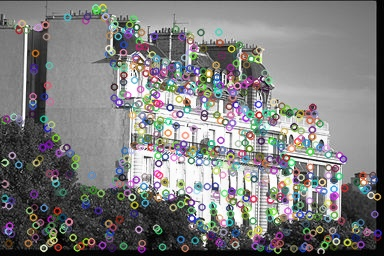

In [3]:
img = cv2.imread('ville01002.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

sift = cv2.xfeatures2d.SIFT_create()

kp, des = sift.detectAndCompute(gray,None)
print(des.shape)

img=cv2.drawKeypoints(gray,kp,img)
cv2.imwrite('sift_keypoints.jpg',img)
Image('sift_keypoints.jpg')

## III. Interest point detector
Speeded-Up Robust Features (SURF)

- document: https://docs.opencv.org/3.4/d5/df7/classcv_1_1xfeatures2d_1_1SURF.html
- tutorial: https://docs.opencv.org/3.4/df/dd2/tutorial_py_surf_intro.html

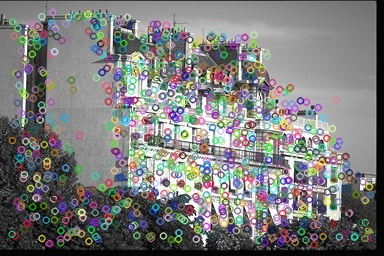

In [4]:
# img = cv2.imread('box.png', 0)
img = cv2.imread('ville01002.jpg', 0)

detector = cv2.xfeatures2d.SURF_create()
keypoints = detector.detect(img)
#-- Draw keypoints
img_keypoints = np.empty((img.shape[0], img.shape[1], 3), dtype=np.uint8)
cv2.drawKeypoints(img, keypoints, img_keypoints)

cv2.imwrite('surf_keypoints.jpg',img_keypoints)
Image('surf_keypoints.jpg')

## VI. Image Matching

In [5]:
img1 = cv2.imread('thaprua.jpg')
img2 = cv2.imread('thaprua2.jpg')
img3 = cv2.imread('chuamotcot.jpg')
img4 = cv2.imread('cotco.jpg')

(<matplotlib.axes._subplots.AxesSubplot at 0x7f0cbd4cfac8>,
 <matplotlib.image.AxesImage at 0x7f0cbd487ac8>)

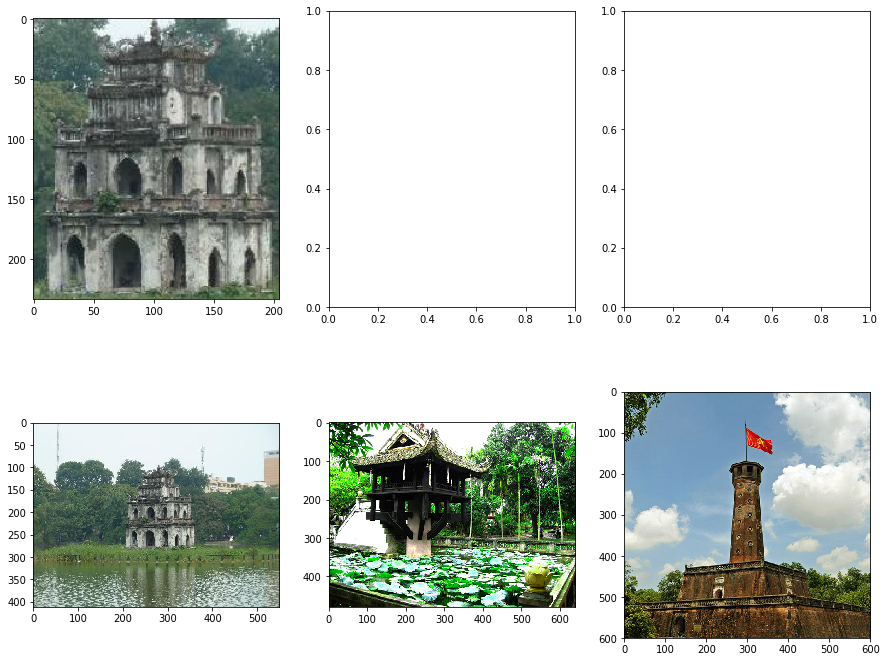

In [6]:
img1_ = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2_ = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
img3_ = cv2.cvtColor(img3, cv2.COLOR_BGR2RGB)
img4_ = cv2.cvtColor(img4, cv2.COLOR_BGR2RGB)
plt.subplots(2, 3, figsize = (15,12))
plt.subplot(231), plt.imshow(img1_)
plt.subplot(234), plt.imshow(img2_)
plt.subplot(235), plt.imshow(img3_)
plt.subplot(236), plt.imshow(img4_)

In [7]:
sift = cv2.xfeatures2d.SIFT_create()

In [8]:
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)
kp3, des3 = sift.detectAndCompute(img3,None)
kp4, des4 = sift.detectAndCompute(img4,None)

In [9]:
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks=50)

In [10]:
flann = cv2.FlannBasedMatcher(index_params,search_params)

In [11]:
matches2 = flann.knnMatch(des1,des2,k=2)
matches3 = flann.knnMatch(des1,des3,k=2)
matches4 = flann.knnMatch(des1,des4,k=2)

Number of matchesMask: 238


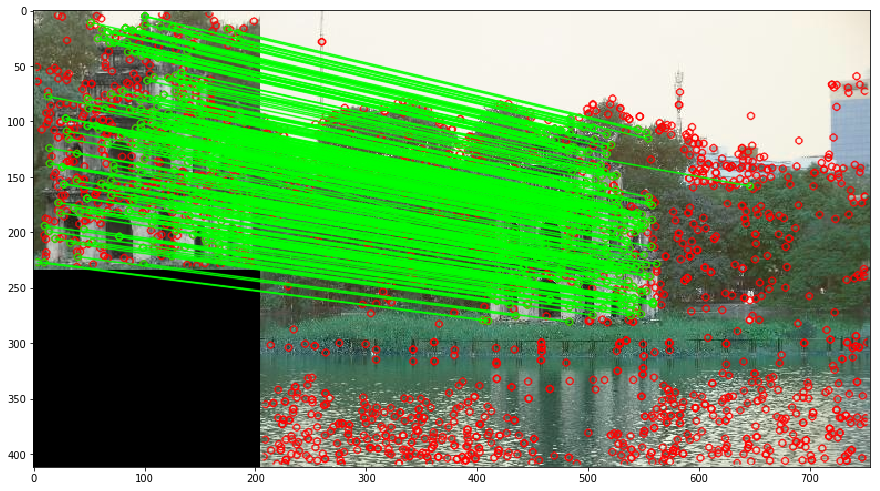

(<matplotlib.image.AxesImage at 0x7f0cbd424a58>, None)

In [12]:
cnt = 0
matchesMask = [[0,0] for i in range(len(matches2))]
for i,(m,n) in enumerate(matches2):
    if m.distance < 0.7*n.distance:
        matchesMask[i]=[1,0]
        cnt += 1
        
print("Number of matchesMask: " + str(cnt))

draw_params = dict(matchColor = (0,255,0),
                   singlePointColor = (255,0,0),
                   matchesMask = matchesMask,
                   flags = 0)

imgRes = cv2.drawMatchesKnn(img1,kp1,img2,kp2,matches2,None,**draw_params)
plt.subplots(1, 1, figsize = (15,12))
plt.imshow(imgRes,),plt.show()

Number of matchesMask: 6


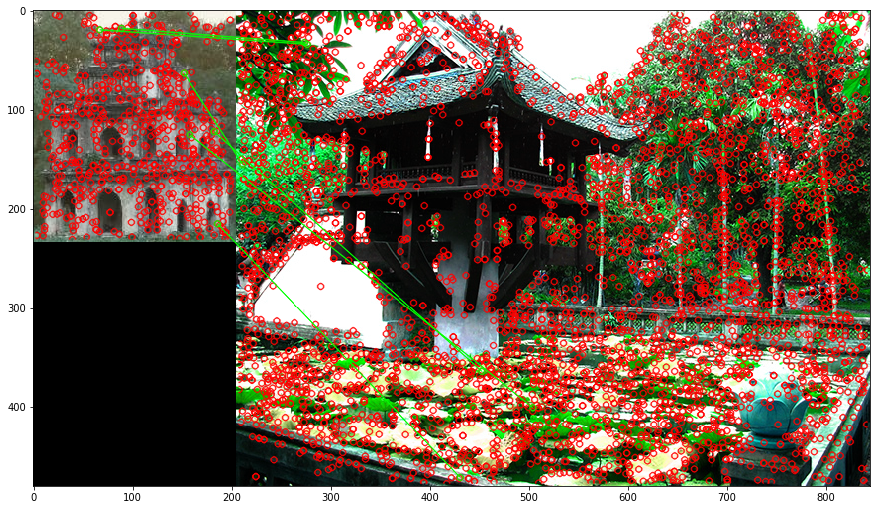

(<matplotlib.image.AxesImage at 0x7f0cbd341e48>, None)

In [13]:
cnt = 0
matchesMask = [[0,0] for i in range(len(matches3))]
for i,(m,n) in enumerate(matches3):
    if m.distance < 0.7*n.distance:
        matchesMask[i]=[1,0]
        cnt += 1
        
print("Number of matchesMask: " + str(cnt))

draw_params = dict(matchColor = (0,255,0),
                   singlePointColor = (255,0,0),
                   matchesMask = matchesMask,
                   flags = 0)

imgRes = cv2.drawMatchesKnn(img1,kp1,img3,kp3,matches3,None,**draw_params)
plt.subplots(1, 1, figsize = (15,12))
plt.imshow(imgRes,),plt.show()


Number of matchesMask: 2


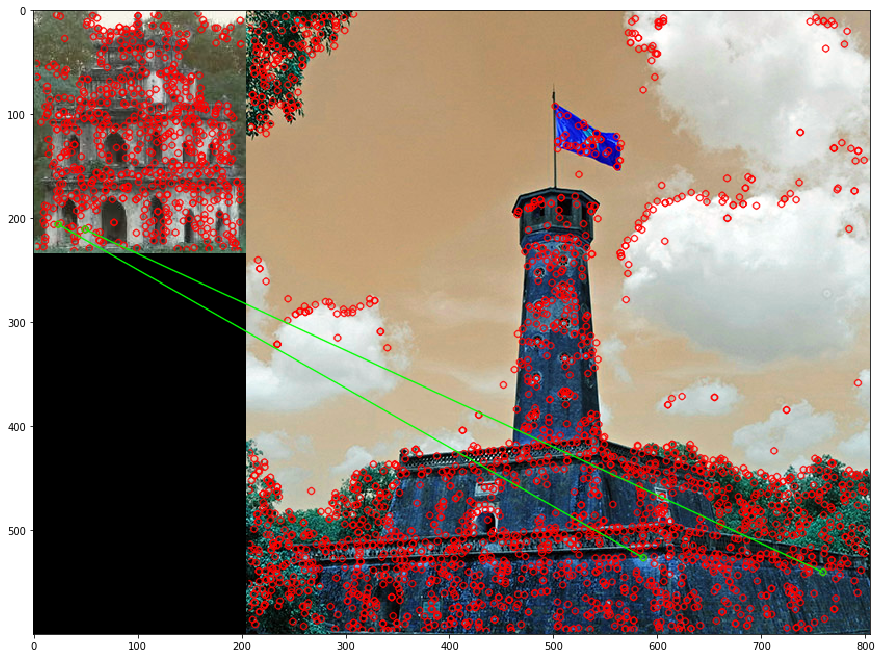

(<matplotlib.image.AxesImage at 0x7f0cbd2fe940>, None)

In [14]:
cnt = 0
matchesMask = [[0,0] for i in range(len(matches4))]
for i,(m,n) in enumerate(matches4):
    if m.distance < 0.7*n.distance:
        matchesMask[i]=[1,0]
        cnt += 1
print("Number of matchesMask: " + str(cnt))

draw_params = dict(matchColor = (0,255,0),
                   singlePointColor = (255,0,0),
                   matchesMask = matchesMask,
                   flags = 0)

imgRes = cv2.drawMatchesKnn(img1,kp1,img4,kp4,matches4,None,**draw_params)
plt.subplots(1, 1, figsize = (15,12))
plt.imshow(imgRes,),plt.show()

## V. Panorama Stitching

(<matplotlib.axes._subplots.AxesSubplot at 0x7f0cbd2cee48>,
 <matplotlib.image.AxesImage at 0x7f0cbd281dd8>)

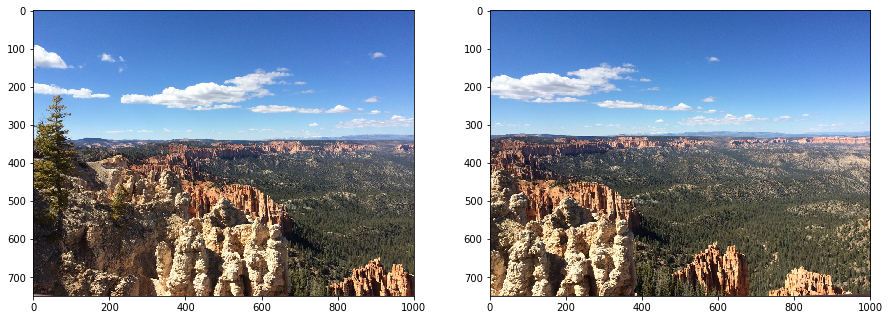

In [15]:
plt.subplots(1, 2, figsize=(15,12))
plt.subplot(121), plt.imshow(plt.imread('./panorama/mountain1_left.png'))
plt.subplot(122), plt.imshow(plt.imread('./panorama/mountain1_right.png'))

### Tự lập trình stitch image

In [16]:
def detectAndDescribe(image):
    # convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # detect and extract features from the image
    descriptor = cv2.xfeatures2d.SIFT_create()
    (kps, features) = descriptor.detectAndCompute(image, None)

    # convert the keypoints from KeyPoint objects to NumPy arrays
    kps = np.float32([kp.pt for kp in kps])

    # return a tuple of keypoints and features
    return (kps, features)

In [17]:
def ransac(keypoints1, keypoints2, matches, n_iters=200, threshold=20):
    """
    Use RANSAC to find a robust affine transformation

        1. Select random set of matches
        2. Compute affine transformation matrix
        3. Compute inliers
        4. Keep the largest set of inliers
        5. Re-compute least-squares estimate on all of the inliers

    Args:
        keypoints1: M1 x 2 matrix, each row is a point
        keypoints2: M2 x 2 matrix, each row is a point
        matches: N x 2 matrix, each row represents a match
            [index of keypoint1, index of keypoint 2]
        n_iters: the number of iterations RANSAC will run
        threshold: the number of threshold to find inliers

    Returns:
        H: a robust estimation of affine transformation from keypoints2 to
        keypoints 1
    """
    pad = lambda x: np.hstack([x, np.ones((x.shape[0], 1))])

    N = matches.shape[0]
    n_samples = int(N * 0.2)

    matched1 = pad(keypoints1[matches[:,0]])
    matched2 = pad(keypoints2[matches[:,1]])

    max_inliers = np.zeros(N)
    n_inliers = 0

    # RANSAC iteration start
    ### YOUR CODE HERE
    for i in range(n_iters):
        temp_max = np.zeros(N, dtype=np.int32)
        temp_n = 0
        idx = np.random.choice(N, n_samples, replace=False)
        p1 = matched1[idx, :]
        p2 = matched2[idx, :]
        H = np.linalg.lstsq(p2, p1, rcond=None)[0]
        H[:, 2] = np.array([0, 0, 1])
        temp_max = np.linalg.norm(matched2.dot(H) - matched1, axis=1) ** 2 < threshold
        temp_n = np.sum(temp_max)
        if temp_n > n_inliers:
            max_inliers = temp_max.copy()
            n_inliers = temp_n
    H = np.linalg.lstsq(matched2[max_inliers], matched1[max_inliers], rcond=None)[0]
    H[:, 2] = np.array([0, 0, 1])
    ### END YOUR CODE
    return H, matches[max_inliers]

In [18]:
def matchKeypoints(kpsA, kpsB, featuresA, featuresB, ratio, reprojThresh):
    # compute the raw matches and initialize the list of actual
    # matches
    matcher = cv2.DescriptorMatcher_create("BruteForce")
    rawMatches = matcher.knnMatch(featuresA, featuresB, 2)
    matches = []

    # loop over the raw matches
    for m in rawMatches:
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if len(m) == 2 and m[0].distance < m[1].distance * ratio:
            matches.append((m[0].trainIdx, m[0].queryIdx))

    # computing a homography requires at least 4 matches
    if len(matches) > 4:
        # construct the two sets of points
        ptsA = np.float32([kpsA[i] for (_, i) in matches])
        ptsB = np.float32([kpsB[i] for (i, _) in matches])

        # compute the homography between the two sets of points
        (H, status) = cv2.findHomography(ptsA, ptsB, cv2.RANSAC,
            reprojThresh)

        # return the matches along with the homograpy matrix
        # and status of each matched point
        return (matches, H, status)

    # otherwise, no homograpy could be computed
    return None

In [19]:
def drawMatches(imageA, imageB, kpsA, kpsB, matches, status):
    # initialize the output visualization image
    (hA, wA) = imageA.shape[:2]
    (hB, wB) = imageB.shape[:2]
    vis = np.zeros((max(hA, hB), wA + wB, 3), dtype="uint8")
    vis[0:hA, 0:wA] = imageA
    vis[0:hB, wA:] = imageB

    # loop over the matches
    for ((trainIdx, queryIdx), s) in zip(matches, status):
        # only process the match if the keypoint was successfully
        # matched
        if s == 1:
            # draw the match
            ptA = (int(kpsA[queryIdx][0]), int(kpsA[queryIdx][1]))
            ptB = (int(kpsB[trainIdx][0]) + wA, int(kpsB[trainIdx][1]))
            cv2.line(vis, ptA, ptB, (0, 255, 0), 1)

    # return the visualization
    return vis

In [20]:
def stitch(images, ratio=0.75, reprojThresh=4.0, showMatches=False):
    # unpack the images, then detect keypoints and extract
    # local invariant descriptors from them
    (imageB, imageA) = images
    (kpsA, featuresA) = detectAndDescribe(imageA)
    (kpsB, featuresB) = detectAndDescribe(imageB)

    # match features between the two images
    M = matchKeypoints(kpsA, kpsB, featuresA, featuresB, ratio, reprojThresh)

    # if the match is None, then there aren't enough matched
    # keypoints to create a panorama
    if M is None:
        return None

    # otherwise, apply a perspective warp to stitch the images
    # together
    (matches, H, status) = M
    result = cv2.warpPerspective(imageA, H, (imageA.shape[1] + imageB.shape[1], imageA.shape[0]))
    result[0:imageB.shape[0], 0:imageB.shape[1]] = imageB

    # check to see if the keypoint matches should be visualized
    if showMatches:
        vis = drawMatches(imageA, imageB, kpsA, kpsB, matches, status)

        # return a tuple of the stitched image and the
        # visualization
        return (result, vis)

    # return the stitched image
    return result

In [21]:
imageA = cv2.imread('./panorama/mountain1_left.png')
imageB = cv2.imread('./panorama/mountain1_right.png')

# stitch the images together to create a panorama
(result, vis) = stitch([imageA, imageB], showMatches=True)

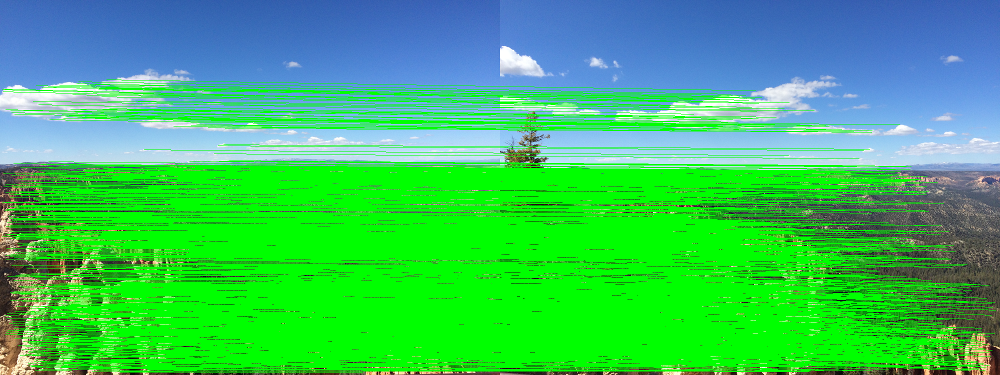

In [22]:
cv2.imwrite('matching.png', vis)
Image('matching.png')

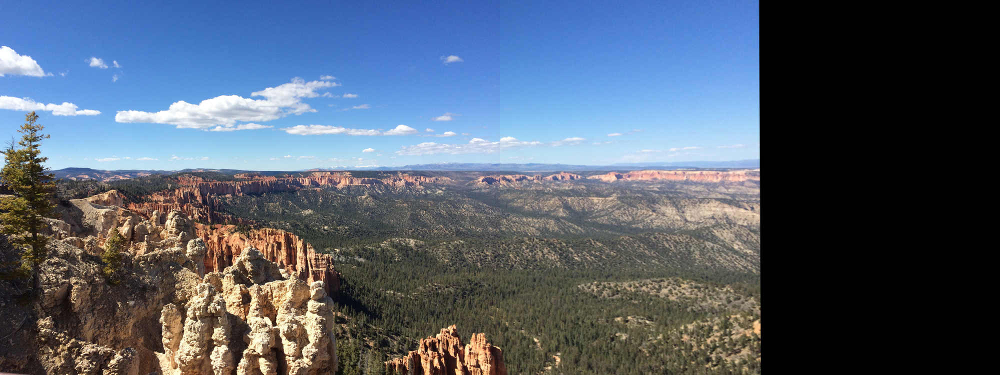

In [23]:
cv2.imwrite('result.png', result)
Image('result.png')

### Sử dụng Stitcher của Opencv

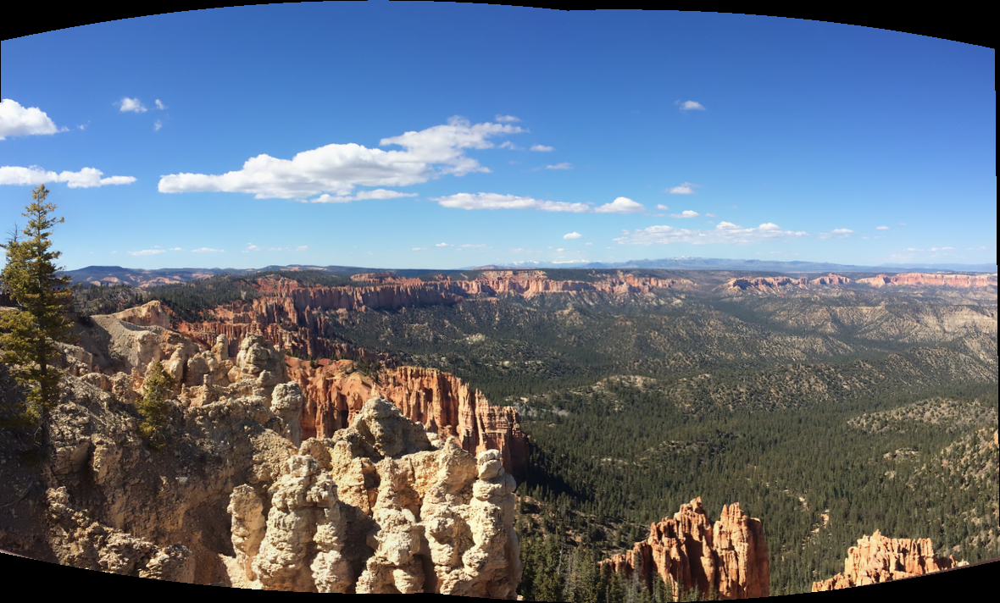

In [24]:
imageA = cv2.imread('./panorama/mountain1_left.png')
imageB = cv2.imread('./panorama/mountain1_right.png')

stitcher = cv2.createStitcher(False)
result = stitcher.stitch((imageA, imageB))

cv2.imwrite('mountain1.png', result[1])
Image('mountain1.png')

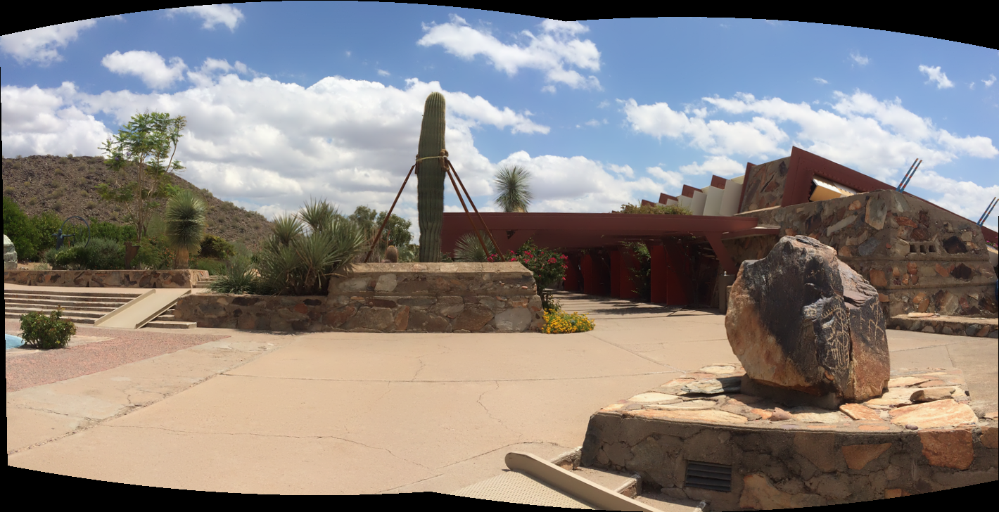

In [25]:
imageA = cv2.imread('./panorama/scottsdale_left.png')
imageB = cv2.imread('./panorama/scottsdale_right.png')

stitcher = cv2.createStitcher(False)
result = stitcher.stitch((imageA, imageB))

cv2.imwrite('scottsdale.png', result[1])
Image('scottsdale.png')

(<matplotlib.axes._subplots.AxesSubplot at 0x7f0cbd1aa780>,
 <matplotlib.image.AxesImage at 0x7f0cbd147160>)

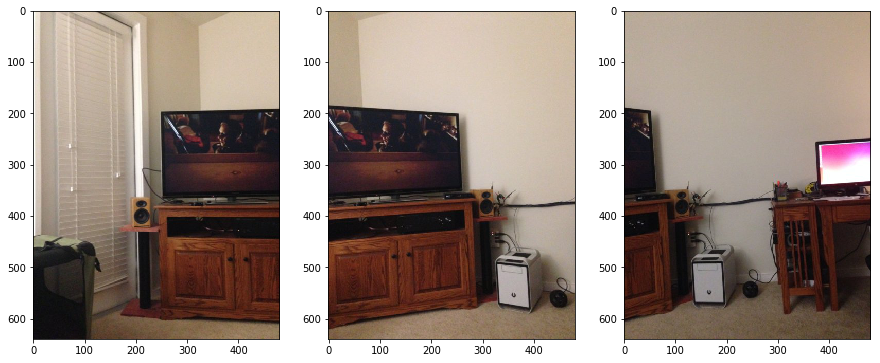

In [26]:
plt.subplots(1, 3, figsize=(15,12))
plt.subplot(131), plt.imshow(plt.imread('./panorama/inside1.jpg'))
plt.subplot(132), plt.imshow(plt.imread('./panorama/inside2.jpg'))
plt.subplot(133), plt.imshow(plt.imread('./panorama/inside3.jpg'))

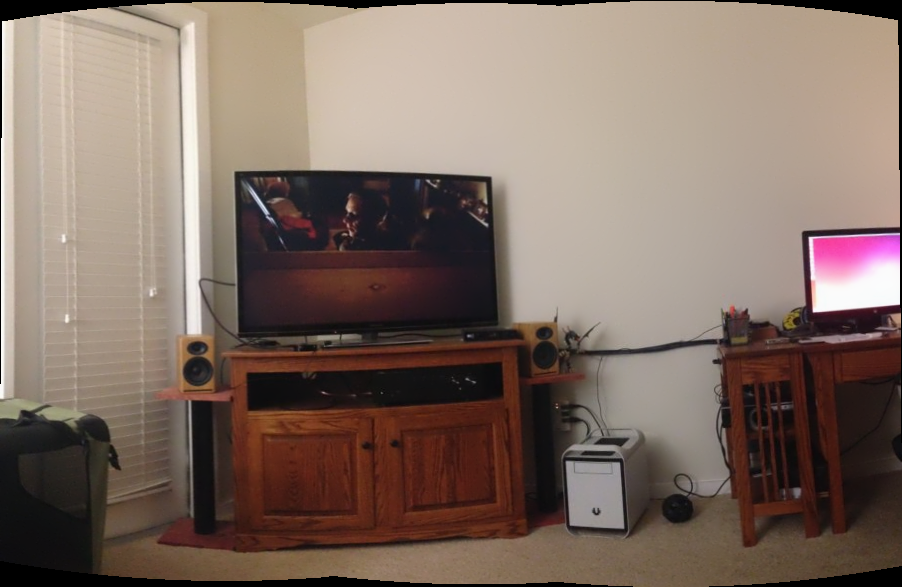

In [28]:
imageA = cv2.imread('./panorama/inside1.jpg')
imageB = cv2.imread('./panorama/inside2.jpg')
imageC = cv2.imread('./panorama/inside3.jpg')

stitcher = cv2.createStitcher(False)
result = stitcher.stitch((imageA, imageB, imageC))

cv2.imwrite('inside.png', result[1])
Image('inside.png')

(<matplotlib.axes._subplots.AxesSubplot at 0x7f0cbd069470>,
 <matplotlib.image.AxesImage at 0x7f0cbd018fd0>)

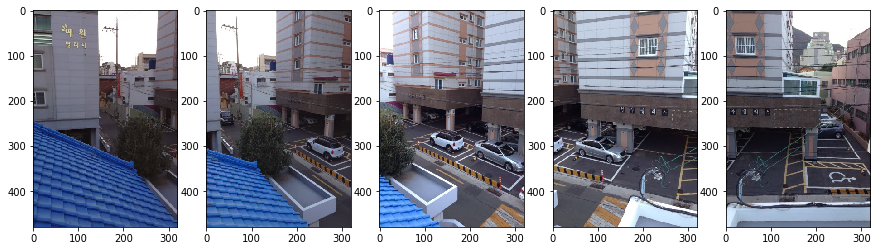

In [29]:
plt.subplots(1, 5, figsize=(15,12))
plt.subplot(151), plt.imshow(plt.imread('./panorama/outside1.jpg'))
plt.subplot(152), plt.imshow(plt.imread('./panorama/outside2.jpg'))
plt.subplot(153), plt.imshow(plt.imread('./panorama/outside3.jpg'))
plt.subplot(154), plt.imshow(plt.imread('./panorama/outside4.jpg'))
plt.subplot(155), plt.imshow(plt.imread('./panorama/outside5.jpg'))

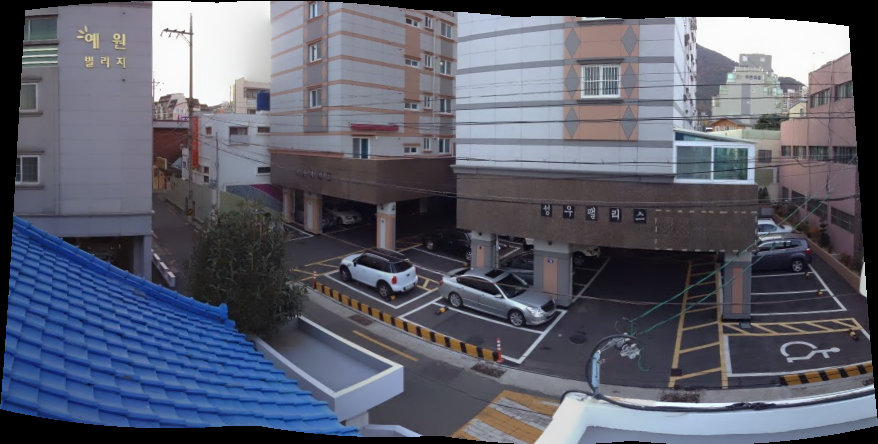

In [30]:
### YOUR CODE HERE

### END YOUR CODE

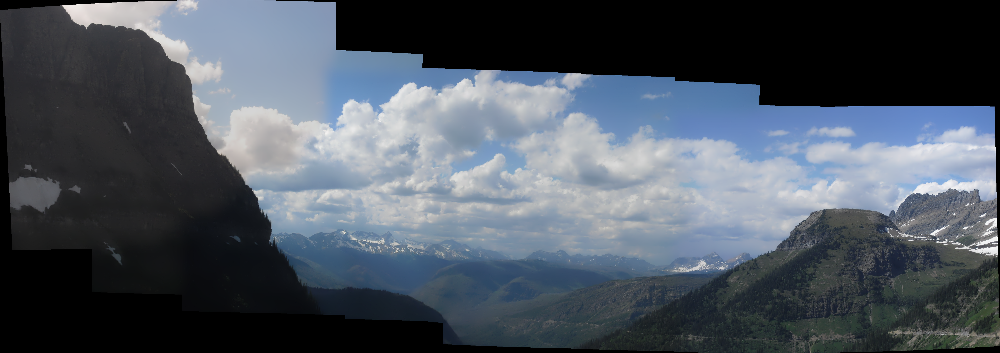

In [31]:
### YOUR CODE HERE

### END YOUR CODE

# BÀI TẬP VỀ NHÀ

1. Thực hành ghép ảnh stitching với các cặp ảnh còn lại trọng thư mục panorama.
2. Thử nghiệm cả 2 hàm image stitching của opencv và hàm tự viết lại phía trên với dữ liệu thực tế chụp bằng điện thoại. 

Cụ thể: Dùng điện thoại chụp 2 bức ảnh với góc chụp thay đổi nhỏ. Dùng 2 hàm stitching trên để ghép ảnh. So sánh kết quả.

3. Better Image Merging: Tìm hiểu phương pháp cải tiến làm mịn phần nối giữa 2 ảnh trong phần hàm tự code
4. Stitching Multiple Images: Lập trình mở rộng hàm stitch phía trên để có thể khâu nhiều ảnh liên tiếp (thay vì chỉ 2 ảnh)

5. Thay đổi hàm trích xuất đặc trưng từ SIFT sang SURF. So sánh thời gian khâu ảnh khi dùng 2 loại đặc trưng này.

### 1.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f0cbd239208>,
 <matplotlib.image.AxesImage at 0x7f0cbd219f28>)

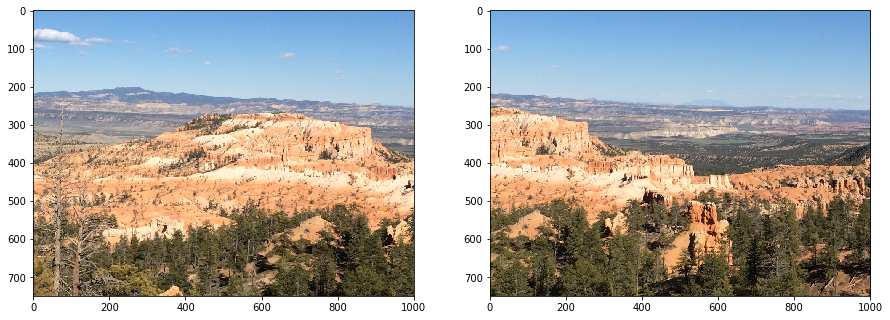

In [32]:
plt.subplots(1, 2, figsize=(15,12))
plt.subplot(121), plt.imshow(plt.imread('./panorama/mountain2_left.png'))
plt.subplot(122), plt.imshow(plt.imread('./panorama/mountain2_right.png'))

(<matplotlib.axes._subplots.AxesSubplot at 0x7f0cbd06d940>,
 <matplotlib.image.AxesImage at 0x7f0cbcf3d8d0>)

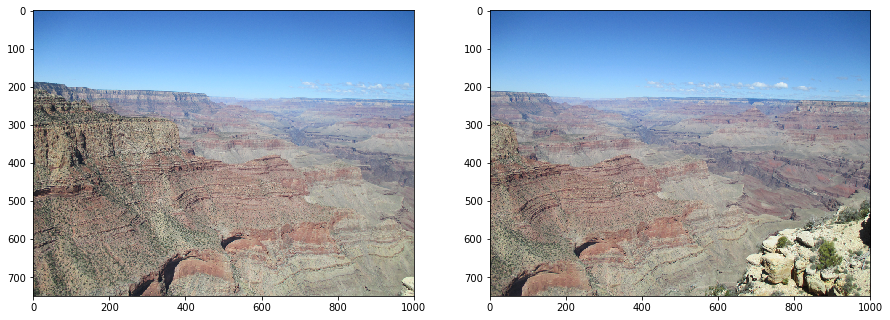

In [33]:
plt.subplots(1, 2, figsize=(15,12))
plt.subplot(121), plt.imshow(plt.imread('./panorama/mountain5_left.png'))
plt.subplot(122), plt.imshow(plt.imread('./panorama/mountain5_right.png'))

### 4.

(<matplotlib.axes._subplots.AxesSubplot at 0x7f0cbceb3048>,
 <matplotlib.image.AxesImage at 0x7f0cbceea048>)

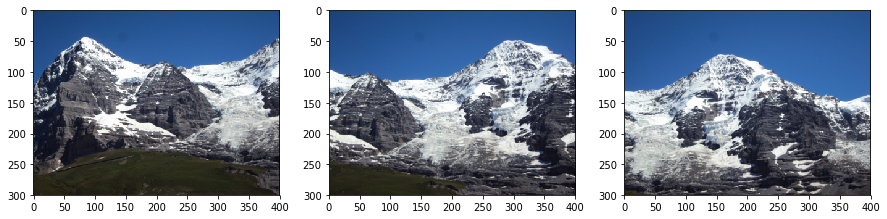

In [34]:
plt.subplots(1, 3, figsize=(15,12))
plt.subplot(131), plt.imshow(plt.imread('./panorama/1Hill.JPG'))
plt.subplot(132), plt.imshow(plt.imread('./panorama/2Hill.JPG'))
plt.subplot(133), plt.imshow(plt.imread('./panorama/3Hill.JPG'))

(<matplotlib.axes._subplots.AxesSubplot at 0x7f0cbcdb0518>,
 <matplotlib.image.AxesImage at 0x7f0cbcde8160>)

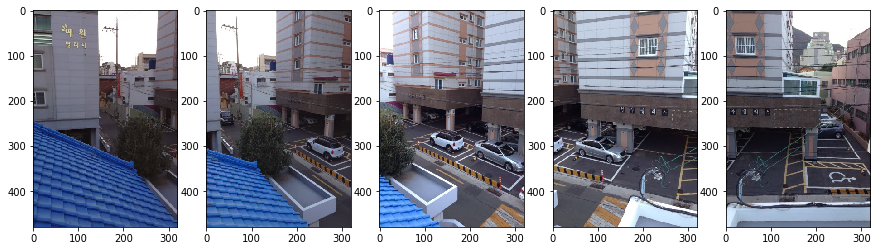

In [35]:
plt.subplots(1, 5, figsize=(15,12))
plt.subplot(151), plt.imshow(plt.imread('./panorama/outside1.jpg'))
plt.subplot(152), plt.imshow(plt.imread('./panorama/outside2.jpg'))
plt.subplot(153), plt.imshow(plt.imread('./panorama/outside3.jpg'))
plt.subplot(154), plt.imshow(plt.imread('./panorama/outside4.jpg'))
plt.subplot(155), plt.imshow(plt.imread('./panorama/outside5.jpg'))

(<matplotlib.axes._subplots.AxesSubplot at 0x7f0cbcb82d30>,
 <matplotlib.image.AxesImage at 0x7f0cbcb43908>)

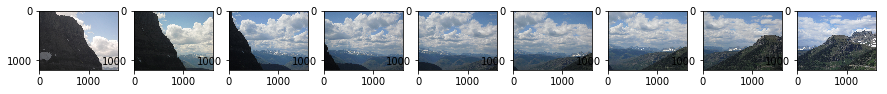

In [36]:
plt.subplots(1, 9, figsize=(15,12))
plt.subplot(191), plt.imshow(plt.imread('./panorama/CIMG1.JPG'))
plt.subplot(192), plt.imshow(plt.imread('./panorama/CIMG2.JPG'))
plt.subplot(193), plt.imshow(plt.imread('./panorama/CIMG3.JPG'))
plt.subplot(194), plt.imshow(plt.imread('./panorama/CIMG4.JPG'))
plt.subplot(195), plt.imshow(plt.imread('./panorama/CIMG5.JPG'))
plt.subplot(196), plt.imshow(plt.imread('./panorama/CIMG6.JPG'))
plt.subplot(197), plt.imshow(plt.imread('./panorama/CIMG7.JPG'))
plt.subplot(198), plt.imshow(plt.imread('./panorama/CIMG8.JPG'))
plt.subplot(199), plt.imshow(plt.imread('./panorama/CIMG9.JPG'))